In [1]:
!pip install hdf5storage

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 45.0/45.0 kB 1.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 75.8/75.8 kB 3.0 MB/s eta 0:00:00


In [2]:
import os
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision.models as models
from torch.utils.data import Dataset, DataLoader
import torch.optim as optim
from torch.cuda.amp import GradScaler, autocast
import hdf5storage as h5
import cv2
import numpy as np
from einops import rearrange
import time
import argparse
from torchvision import transforms
import torchvision.utils as vutils
import wandb  # Optional for logging
import matplotlib.pyplot as plt


# ---------------------------
# Model Architecture (Your Transformer+U-Net)
# ---------------------------
class TransformerBlock(nn.Module):
    def __init__(self, dim, heads, mlp_ratio=4.0, p=0.0):
        super().__init__()
        self.n1 = nn.LayerNorm(dim)
        self.attn = nn.MultiheadAttention(dim, heads, dropout=p, batch_first=False)
        self.n2 = nn.LayerNorm(dim)
        self.mlp = nn.Sequential(
            nn.Linear(dim, int(dim*mlp_ratio)), nn.GELU(), nn.Linear(int(dim*mlp_ratio), dim)
        )
    def forward(self, x):  # x: [HW,B,D]
        h = self.n1(x)
        a, _ = self.attn(h, h, h, need_weights=False)
        x = x + a
        x = x + self.mlp(self.n2(x))
        return x

class MultiStageTransformerEncoder(nn.Module):
    def __init__(self, img_channels=3, embed_dims=[64,128,256], patch_sizes=[8,16,2], depths=[2,2,2], heads=[2,4,8]):
        super().__init__()
        self.stages = nn.ModuleList()
        self.embed_dims = embed_dims
        for i, d in enumerate(embed_dims):
            in_ch = img_channels if i == 0 else embed_dims[i-1]
            self.stages.append(nn.ModuleDict({
                "proj": nn.Conv2d(in_ch, d, kernel_size=patch_sizes[i], stride=patch_sizes[i]),
                "blocks": nn.ModuleList([TransformerBlock(d, heads[i]) for _ in range(depths[i])])
            }))
    def forward(self, x):
        skips = []
        for s in self.stages:
            x = s["proj"](x)             # [B,D,h,w]
            B, D, h, w = x.shape
            x_seq = rearrange(x, "b d h w -> (h w) b d")
            for blk in s["blocks"]:
                x_seq = blk(x_seq)
            x = rearrange(x_seq, "(h w) b d -> b d h w", h=h, w=w)
            skips.append(x)
        return skips  # [low-res ... high-res]

class UNetDecoder(nn.Module):
    def __init__(self, embed_dims=[64,128,256], out_ch=2):
        super().__init__()
        self.up1 = nn.ConvTranspose2d(embed_dims[2], embed_dims[1], 2, 2)
        self.c1  = nn.Sequential(nn.Conv2d(embed_dims[1]*2, embed_dims[1], 3, padding=1), nn.ReLU(True),
                                 nn.Conv2d(embed_dims[1], embed_dims[1], 3, padding=1), nn.ReLU(True))
        self.up2 = nn.ConvTranspose2d(embed_dims[1], embed_dims[0], 2, 2)
        self.c2  = nn.Sequential(nn.Conv2d(embed_dims[0]*2, embed_dims[0], 3, padding=1), nn.ReLU(True),
                                 nn.Conv2d(embed_dims[0], embed_dims[0], 3, padding=1), nn.ReLU(True))
        self.up3 = nn.ConvTranspose2d(embed_dims[0], embed_dims[0]//2, 2, 2)
        self.c3  = nn.Sequential(nn.Conv2d(embed_dims[0]//2, embed_dims[0]//2, 3, padding=1), nn.ReLU(True))
        self.out = nn.Conv2d(embed_dims[0]//2, out_ch, 1)
    def forward(self, skips):
        x = skips[-1]
        x = self.up1(x)
        s1 = F.interpolate(skips[1], size=x.shape[-2:], mode='bilinear', align_corners=False)
        x = torch.cat([x, s1], dim=1); x = self.c1(x)

        x = self.up2(x)
        s0 = F.interpolate(skips[0], size=x.shape[-2:], mode='bilinear', align_corners=False)
        x = torch.cat([x, s0], dim=1); x = self.c2(x)

        x = self.up3(x); x = self.c3(x)
        return self.out(x)

class FlowGenerator(nn.Module):
    """Predicts flow to transform input between domains."""
    def __init__(self, img_channels=3, max_disp=48.0):
        super().__init__()
        self.enc = MultiStageTransformerEncoder(img_channels=img_channels)
        self.dec = UNetDecoder()
        self.max_disp = max_disp
    def forward(self, x):
        B, C, H, W = x.shape
        skips = self.enc(x)
        flow = self.dec(skips)
        flow = F.interpolate(flow, size=(H, W), mode='bilinear', align_corners=False)
        # constrain displacement magnitude for stability
        # flow = torch.tanh(flow) * self.max_disp
        flow = flow * 10.0  # EXPERIMENT: 10x amplification for visibility
        return flow

In [3]:
from io import BytesIO
from PIL import Image

# --- Visualization helper ---
def prepare_tensor(tensor):
    if isinstance(tensor, np.ndarray):
        if tensor.ndim == 4:
            tensor = tensor[0]  # remove batch dimension
        if tensor.shape[0] in [1, 3, 4]:  # channels first
            tensor = tensor.transpose(1, 2, 0)  # convert to channels last
        return tensor
    if tensor.requires_grad:
        tensor = tensor.detach()
    tensor = tensor.cpu().numpy()
    if tensor.ndim == 4:
        tensor = tensor[0]
    if tensor.shape[0] in [1, 3, 4]:
        tensor = tensor.transpose(1, 2, 0)
    return tensor

def visualize_flow(flow, save_path=None, verbose=True):
    """Visualize flow field as RGB image"""
    try:
        flow = flow.squeeze(0).cpu().numpy()
    except:
        flow = flow.squeeze(0)
    
    # Convert flow to HSV color representation
    h, w = flow.shape[1:]
    hsv = np.zeros((h, w, 3), dtype=np.uint8)
    
    # Magnitude and angle
    mag, ang = cv2.cartToPolar(flow[0], flow[1])
    
    # Normalize for visualization
    hsv[..., 0] = ang * 180 / np.pi / 2
    hsv[..., 1] = 255
    hsv[..., 2] = cv2.normalize(mag, None, 0, 255, cv2.NORM_MINMAX)
    
    # Convert to BGR and save
    bgr = cv2.cvtColor(hsv, cv2.COLOR_HSV2BGR)
    
    if save_path is not None:
        cv2.imwrite(save_path, bgr)

    # Create plot
    if verbose:
        plt.figure(figsize=(10, 8))
        plt.imshow(bgr)
        plt.axis('off')
        plt.title('Optical Flow Visualization')
        plt.tight_layout()
        plt.show()
        
    return bgr

def apply_bm_doc3d(img, bm_pix, align_corners=True, padding_mode="border", verbose=False, save_path=None):
    """
    Warp an image using a backward map in pixel coordinates.

    Args:
        img: (B, C, H, W) tensor in [0,1], warped image
        bm_pix: (B, 2, H, W) tensor in pixels, backward map (absolute coords)
                bm_pix[:,0] = x pixel coords
                bm_pix[:,1] = y pixel coords
        align_corners: bool, matches normalization convention in grid_sample
        padding_mode: str, 'border' or 'zeros'

    Returns:
        rectified: (B, C, H, W) tensor, unwarped image
    """
    # if len(img.shape) == 3:
    #     img = img.unsqueeze(0)
    #     bm_pix = bm_pix.unsqueeze(0)
        
    B, C, H, W = img.shape

    # convert pixel coords -> normalized [-1,1]
    if align_corners:
        norm_x = (bm_pix[:, 0, :, :] / (W - 1)) * 2 - 1
        norm_y = (bm_pix[:, 1, :, :] / (H - 1)) * 2 - 1
    else:
        norm_x = (2 * bm_pix[:, 0, :, :] + 1) / W - 1
        norm_y = (2 * bm_pix[:, 1, :, :] + 1) / H - 1

    grid = torch.stack([norm_x, norm_y], dim=-1)  # (B,H,W,2)

    rectified = F.grid_sample(
        img, grid, mode="bilinear",
        padding_mode=padding_mode, align_corners=align_corners
    )

    # For PyTorch tensors with requires_grad
    def prepare_tensor(tensor):
        if tensor.requires_grad:
            tensor = tensor.detach()
        tensor = tensor.cpu().numpy()
        if tensor.ndim == 4:
            tensor = tensor[0]
        if tensor.shape[0] in [1, 3, 4]:
            tensor = tensor.transpose(1, 2, 0)
        return tensor
        
    if verbose:
        img_display = prepare_tensor(img)
        rectified_display = prepare_tensor(rectified)
        
        f,axrr=plt.subplots(1,2)
        for ax in axrr:
            ax.set_xticks([])
            ax.set_yticks([])
        axrr[0].imshow(img_display)
        axrr[0].title.set_text('input')
        axrr[1].imshow(rectified_display)
        axrr[1].title.set_text('unwarped')
        if save_path is not None:
            plt.savefig(save_path)
        plt.show()
        
    return rectified

def visualize_epoch_results(model, dataloader, device, epoch, max_batches=1):
    model.eval()
    images, target_flows, target_flows_norm = next(iter(dataloader))
    print(images.shape)
    # image_tensor, target_flow_tensor, target_flow_norm_tensor = dataloader[0]

    # image_tensor, bm_tensor, _ = dataset[i]  # image: (3,H,W), bm: (2,H,W)
    image_tensor = images[0].unsqueeze(0).to(device)   # -> (1,3,H,W)
    target_flow_tensor    = target_flows[0].unsqueeze(0).to(device)      # -> (1,2,H,W)

    # images = images.to(device)
    # target_flows = target_flows.to(device)

    with torch.no_grad():
        pred_flows = model(image_tensor)

    # B, _, H, W = pred_flows.shape

    original = images[0]
    target_flow = visualize_flow(target_flow_tensor, verbose=False)
    pred_flow = visualize_flow(pred_flows, verbose=False)

    # (1) Ground-truth dewarp
    with torch.no_grad():
        target_dewarped = apply_bm_doc3d(image_tensor, target_flow_tensor)
        pred_dewarped = apply_bm_doc3d(image_tensor, pred_flows)
    
    # Create the plot
    fig, axes = plt.subplots(2, 3, figsize=(15, 8))
    
    # Row titles
    axes[0, 0].set_ylabel('Target', fontsize=14, fontweight='bold', rotation=0, labelpad=40)
    axes[1, 0].set_ylabel('Predicted', fontsize=14, fontweight='bold', rotation=0, labelpad=40)
    
    # Column titles
    col_titles = ['Original', 'Dewarped', 'Flow']
    for i, title in enumerate(col_titles):
        axes[0, i].set_title(title, fontsize=12, fontweight='bold')
    
    # Plot target row
    axes[0, 0].imshow(prepare_tensor(original))
    axes[0, 1].imshow(prepare_tensor(target_dewarped))
    axes[0, 2].imshow(prepare_tensor(target_flow))
    
    # Plot predicted row
    axes[1, 0].imshow(prepare_tensor(original))
    axes[1, 1].imshow(prepare_tensor(pred_dewarped))
    axes[1, 2].imshow(prepare_tensor(pred_flow))
    
    # Remove ticks from all axes
    for ax_row in axes:
        for ax in ax_row:
            ax.set_xticks([])
            ax.set_yticks([])
            
    plt.tight_layout()
    plt.savefig(f"epoch_{epoch}_warps", dpi=300, bbox_inches='tight')
    
    # Save figure to bytes buffer
    buf = BytesIO()
    plt.savefig(buf, format='png', dpi=300, bbox_inches='tight')
    buf.seek(0)

    # Convert to PIL Image
    pil_image = Image.open(buf)
    
    # Log to wandb
    wandb.log({
        f"epoch_{epoch}_warps": wandb.Image(pil_image, caption="Input | Warp | Flow")
    })

In [4]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f'Using device: {device}')

max_disp = 48
model = FlowGenerator(max_disp=max_disp).to(device)

ckpt_path = '/kaggle/input/supervised-dewarping/checkpoints/checkpoint_epoch_98.pth'
checkpoint = torch.load(ckpt_path, map_location=device)
print(checkpoint.keys())
model.load_state_dict(checkpoint['model_state_dict'])

Using device: cpu
dict_keys(['epoch', 'model_state_dict', 'optimizer_state_dict', 'train_loss', 'val_loss'])


<All keys matched successfully>

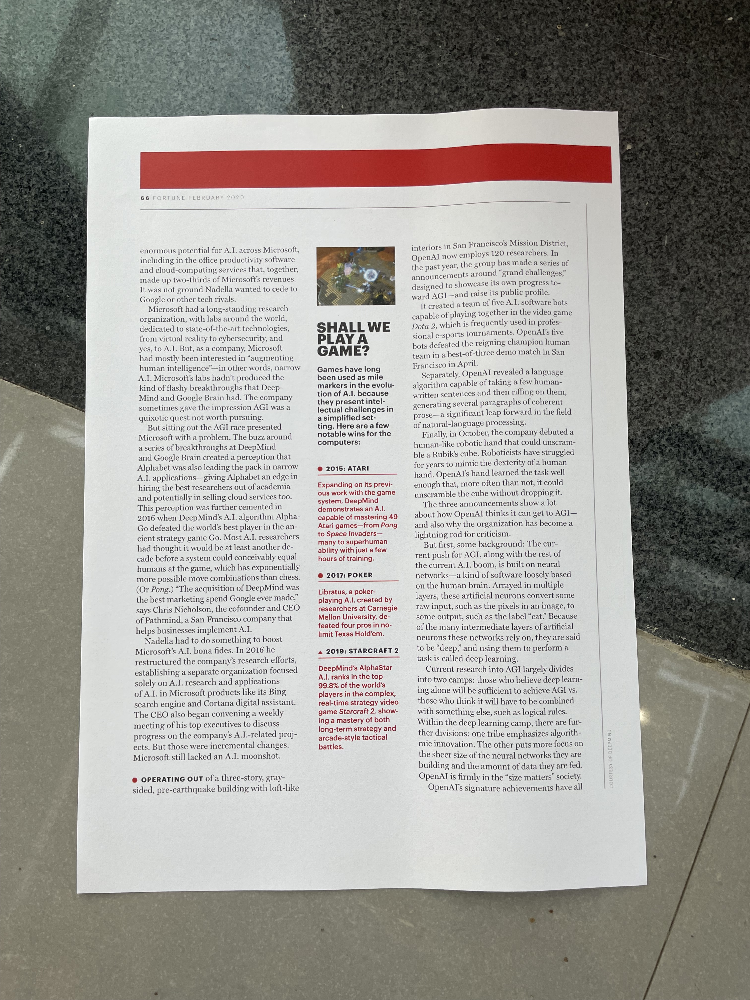

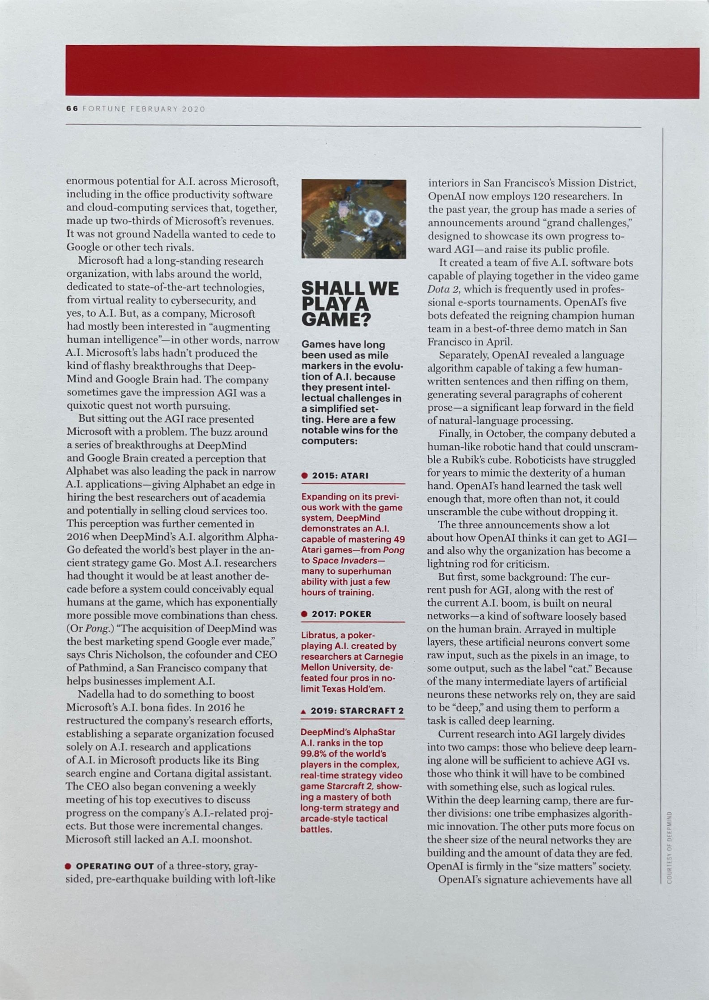

In [5]:
from PIL import Image

warped_img_path_doc3d = '/kaggle/input/doc3d-100k/img_1/img/1/1000_4-pp_Page_847-Pwi0001.png'
warped_img_path = '/kaggle/input/dir300/DIR300/dist/10.png'
flat_img_path = '/kaggle/input/dir300/DIR300/gt/10.png'

display(Image.open(warped_img_path))
display(Image.open(flat_img_path))

In [6]:
def load_img(img_path, target_size=(448, 448)):
    image = cv2.imread(img_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    if target_size is not None:
        image = cv2.resize(image, target_size)
    image_tensor = torch.from_numpy(image).float().permute(2, 0, 1) / 255.0
    return image_tensor

In [7]:
img_tensor = load_img(warped_img_path).unsqueeze(0)
print(img_tensor.shape)

with torch.no_grad():
    flow = model(img_tensor)
    
dewarped = apply_bm_doc3d(img_tensor, flow)
dewarped

torch.Size([1, 3, 448, 448])


tensor([[[[0.8783, 0.8783, 0.8783,  ..., 0.5291, 0.5291, 0.5291],
          [0.8783, 0.8783, 0.8783,  ..., 0.5291, 0.5291, 0.5291],
          [0.8783, 0.8783, 0.8783,  ..., 0.5291, 0.5291, 0.5291],
          ...,
          [0.8517, 0.8517, 0.8517,  ..., 0.5909, 0.5909, 0.5909],
          [0.8517, 0.8517, 0.8517,  ..., 0.5909, 0.5909, 0.5909],
          [0.8517, 0.8517, 0.8517,  ..., 0.5909, 0.5909, 0.5909]],

         [[0.8955, 0.8955, 0.8955,  ..., 0.0948, 0.0948, 0.0948],
          [0.8955, 0.8955, 0.8955,  ..., 0.0948, 0.0948, 0.0948],
          [0.8955, 0.8955, 0.8955,  ..., 0.0948, 0.0948, 0.0948],
          ...,
          [0.8595, 0.8595, 0.8595,  ..., 0.5926, 0.5926, 0.5926],
          [0.8595, 0.8595, 0.8595,  ..., 0.5926, 0.5926, 0.5926],
          [0.8595, 0.8595, 0.8595,  ..., 0.5926, 0.5926, 0.5926]],

         [[0.8806, 0.8806, 0.8806,  ..., 0.1025, 0.1025, 0.1025],
          [0.8806, 0.8806, 0.8806,  ..., 0.1025, 0.1025, 0.1025],
          [0.8806, 0.8806, 0.8806,  ..., 0

In [8]:
img_tensor_no_reshape = load_img(warped_img_path, target_size=None).unsqueeze(0)
print(img_tensor_no_reshape.shape)
dewarped_no_reshape = apply_bm_doc3d(img_tensor_no_reshape, flow)
dewarped_no_reshape

torch.Size([1, 3, 4032, 3024])


tensor([[[[0.3431, 0.3431, 0.3431,  ..., 0.3661, 0.3661, 0.3661],
          [0.3431, 0.3431, 0.3431,  ..., 0.3661, 0.3661, 0.3661],
          [0.3431, 0.3431, 0.3431,  ..., 0.3661, 0.3661, 0.3661],
          ...,
          [0.2511, 0.2511, 0.2511,  ..., 0.3983, 0.3983, 0.3983],
          [0.2511, 0.2511, 0.2511,  ..., 0.3983, 0.3983, 0.3983],
          [0.2511, 0.2511, 0.2511,  ..., 0.3983, 0.3983, 0.3983]],

         [[0.4058, 0.4058, 0.4058,  ..., 0.4053, 0.4053, 0.4053],
          [0.4058, 0.4058, 0.4058,  ..., 0.4053, 0.4053, 0.4053],
          [0.4058, 0.4058, 0.4058,  ..., 0.4053, 0.4053, 0.4053],
          ...,
          [0.2746, 0.2746, 0.2746,  ..., 0.4493, 0.4493, 0.4493],
          [0.2746, 0.2746, 0.2746,  ..., 0.4493, 0.4493, 0.4493],
          [0.2746, 0.2746, 0.2746,  ..., 0.4493, 0.4493, 0.4493]],

         [[0.3666, 0.3666, 0.3666,  ..., 0.3739, 0.3739, 0.3739],
          [0.3666, 0.3666, 0.3666,  ..., 0.3739, 0.3739, 0.3739],
          [0.3666, 0.3666, 0.3666,  ..., 0

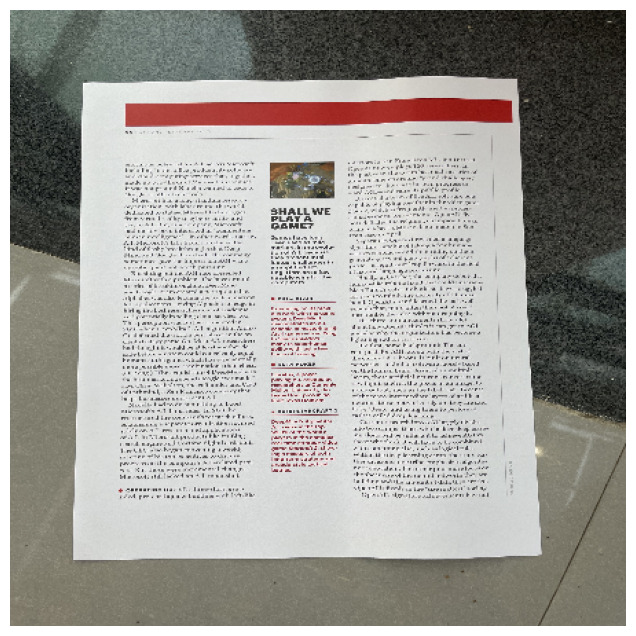

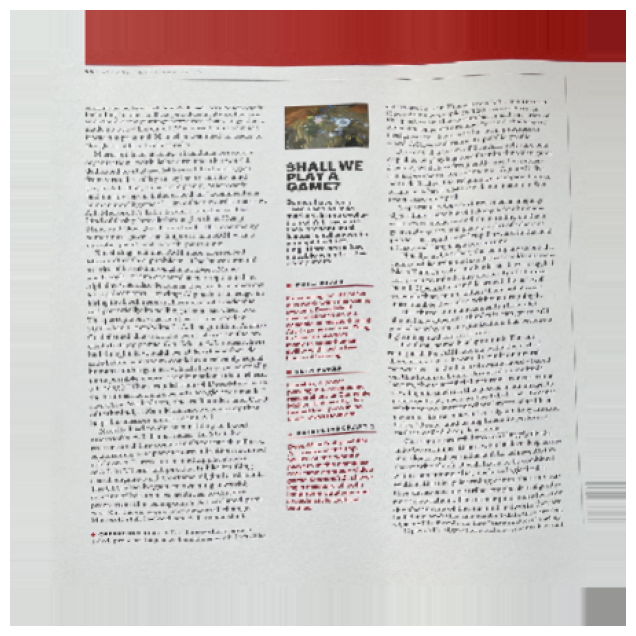

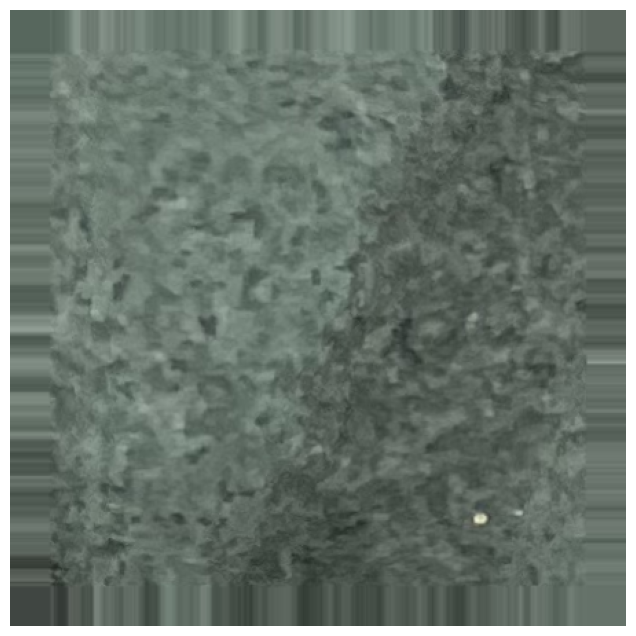

In [9]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 8))
plt.imshow(prepare_tensor(img_tensor))
plt.axis('off')
plt.show()

plt.figure(figsize=(10, 8))
plt.imshow(prepare_tensor(dewarped))
plt.axis('off')
plt.show()

plt.figure(figsize=(10, 8))
plt.imshow(prepare_tensor(dewarped_no_reshape))
plt.axis('off')
plt.show()

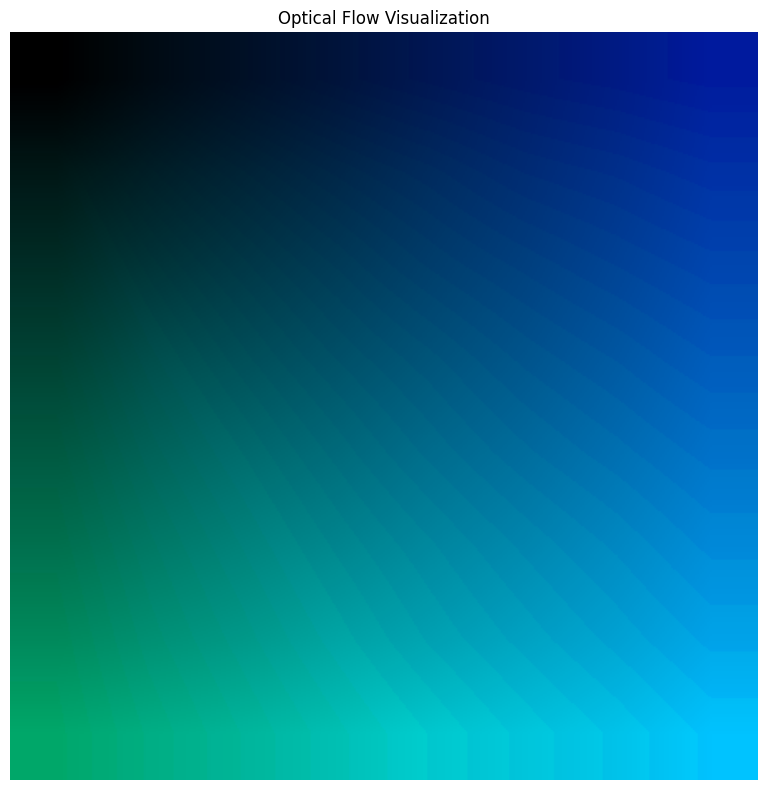

array([[[  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0],
        ...,
        [  0,  26, 158],
        [  0,  26, 158],
        [  0,  26, 158]],

       [[  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0],
        ...,
        [  0,  26, 158],
        [  0,  26, 158],
        [  0,  26, 158]],

       [[  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0],
        ...,
        [  0,  26, 158],
        [  0,  26, 158],
        [  0,  26, 158]],

       ...,

       [[  0, 167, 105],
        [  0, 167, 105],
        [  0, 167, 105],
        ...,
        [  0, 195, 255],
        [  0, 195, 255],
        [  0, 195, 255]],

       [[  0, 167, 105],
        [  0, 167, 105],
        [  0, 167, 105],
        ...,
        [  0, 195, 255],
        [  0, 195, 255],
        [  0, 195, 255]],

       [[  0, 167, 105],
        [  0, 167, 105],
        [  0, 167, 105],
        ...,
        [  0, 195, 255],
        [  0, 195, 255],
        [  0, 195, 255]]

In [10]:
visualize_flow(flow.detach().numpy())

## Addressing bad high-resolution inference results

In [ ]:
def save_dewarped_result(dewarped_tensor, out_path, clip=True, verbose=False):
    """
    Save a dewarped image tensor to file
    
    Args:
        dewarped_tensor: torch.Tensor of shape [1, 3, H, W] or [3, H, W] in range [0, 1]
        out_path: path to save the image
        clip: whether to clip values to [0, 1] range
        verbose: whether to print debug information
    """
    # Ensure we're working with CPU numpy array
    if hasattr(dewarped_tensor, 'detach'):
        dewarped_tensor = dewarped_tensor.detach()
    if hasattr(dewarped_tensor, 'cpu'):
        dewarped_tensor = dewarped_tensor.cpu()
    if hasattr(dewarped_tensor, 'numpy'):
        dewarped_tensor = dewarped_tensor.numpy()
    
    # Handle different tensor shapes
    if dewarped_tensor.ndim == 4:  # [B, C, H, W]
        dewarped_tensor = dewarped_tensor[0]  # Take first batch
    if dewarped_tensor.ndim == 3:  # [C, H, W]
        dewarped_tensor = dewarped_tensor.transpose(1, 2, 0)  # [H, W, C]
    
    # Clip values to valid range
    if clip:
        dewarped_tensor = np.clip(dewarped_tensor, 0, 1)
    
    # Convert to 8-bit and change channel order for OpenCV
    dewarped_image = (dewarped_tensor * 255).astype(np.uint8)
    dewarped_image = cv2.cvtColor(dewarped_image, cv2.COLOR_RGB2BGR)
    
    # Save image
    success = cv2.imwrite(out_path, dewarped_image)
    
    if verbose:
        print(f"Saved dewarped image to: {out_path}")
        print(f"Image shape: {dewarped_image.shape}")
        print(f"Value range: [{dewarped_tensor.min():.3f}, {dewarped_tensor.max():.3f}]")
        print(f"Save successful: {success}")
    
    return success

In [21]:
def scale_flow_to_resolution(flow_low_res, low_res, high_res):
    """
    Scale flow from low resolution to high resolution
    flow_low_res: [1, 2, H_low, W_low]
    low_res: (H_low, W_low)
    high_res: (H_high, W_high)
    """
    H_low, W_low = low_res
    H_high, W_high = high_res
    
    # Scale factors
    scale_x = W_high / W_low
    scale_y = H_high / H_low
    
    # Resize flow
    flow_high_res = F.interpolate(flow_low_res, size=(H_high, W_high), 
                                 mode='bilinear', align_corners=False)
    
    # Scale flow values
    flow_high_res[:, 0, :, :] *= scale_x  # x coordinates
    flow_high_res[:, 1, :, :] *= scale_y  # y coordinates
    
    return flow_high_res
    
    
def dewarp_high_res_scaled(model, high_res_img_path, device, out_path=None, target_size=(448, 448)):
    """Dewarp by scaling flow to high resolution"""
    # Load high-res image
    high_res_img = cv2.imread(high_res_img_path)
    high_res_img = cv2.cvtColor(high_res_img, cv2.COLOR_BGR2RGB)
    original_size = high_res_img.shape[:2]  # (H, W)
    
    # Resize to training size for prediction
    img_resized = cv2.resize(high_res_img, target_size)
    img_tensor = torch.from_numpy(img_resized).float().permute(2, 0, 1) / 255.0
    img_tensor = img_tensor.unsqueeze(0).to(device)
    
    # Predict flow on resized image
    with torch.no_grad():
        flow_low_res = model(img_tensor)  # [1, 2, 448, 448]
    
    # Scale flow to original resolution
    flow_high_res = scale_flow_to_resolution(flow_low_res, target_size, original_size)
    
    # Prepare high-res image tensor
    img_high_res_tensor = torch.from_numpy(high_res_img).float().permute(2, 0, 1) / 255.0
    img_high_res_tensor = img_high_res_tensor.unsqueeze(0).to(device)
    
    # Apply scaled flow to high-res image
    dewarped_high_res = apply_bm_doc3d(img_high_res_tensor, flow_high_res, align_corners=True)
    
    # Save
    if out_path is not None:
        save_dewarped_result(dewarped_high_res, out_path)

    return dewarped_high_res, high_res_img

In [22]:
dewarped_no_reshape, high_res_img = dewarp_high_res_scaled(model, warped_img_path, 'cpu', "dewarped_dir300_1.png")

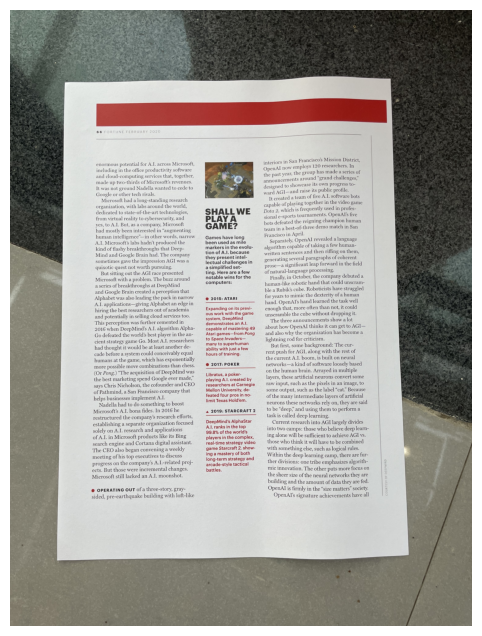

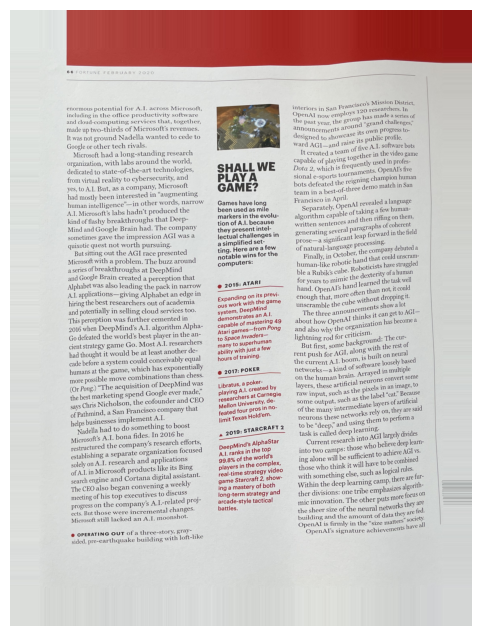

In [13]:
plt.figure(figsize=(10, 8))
plt.imshow(prepare_tensor(high_res_img))
plt.axis('off')
plt.show()

plt.figure(figsize=(10, 8))
plt.imshow(prepare_tensor(dewarped_no_reshape))
plt.axis('off')
plt.show()